In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [2]:
import glob
import cv2
import time 
import matplotlib.pyplot as plt
import numpy as np
import torch
from torchvision import transforms
from torch.utils.data import DataLoader
from torchvision import datasets
from torch.optim import Adam
from torch.autograd import Variable
from PIL import Image, ImageFile

from fast_neural_style.transformer_net import TransformerNet
from fast_neural_style.utils import (
    gram_matrix, recover_image, tensor_normalizer
)
from fast_neural_style.loss_network import LossNetwork

%matplotlib inline
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [3]:
SEED = 1080
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)
    torch.set_default_tensor_type('torch.cuda.FloatTensor')
    kwargs = {'num_workers': 4, 'pin_memory': True}
else:
    torch.set_default_tensor_type('torch.FloatTensor')
    kwargs = {}

# Dataloader

In [4]:
IMAGE_SIZE = 224
BATCH_SIZE = 4
DATASET = "/tmp2/vincentwu929/coco/"
transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE), 
    transforms.CenterCrop(IMAGE_SIZE),
    transforms.ToTensor(), tensor_normalizer()])
# http://pytorch.org/docs/master/torchvision/datasets.html#imagefolder
train_dataset = datasets.ImageFolder(DATASET, transform)
# http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, **kwargs)

# Setup Model

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
with torch.no_grad():
    loss_network = LossNetwork()
    loss_network.to(device)
loss_network.eval()

LossNetwork(
  (vgg_layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (17): ReL

# Load Style Target

In [6]:
style_name = 'crayon' #'crayon', 'fountainpen', 'ZaoWouKi'

In [7]:
STYLE_IMAGE = "./style_images/1.jpg"
style_img = Image.open(STYLE_IMAGE).convert('RGB')
with torch.no_grad():
    style_img_tensor = transforms.Compose([
        transforms.Resize(IMAGE_SIZE* 2),
        transforms.ToTensor(),
        tensor_normalizer()]
    )(style_img).unsqueeze(0)
    style_img_tensor = style_img_tensor.to(device)

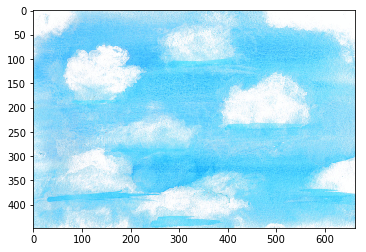

In [8]:
plt.imshow(recover_image(style_img_tensor.cpu().numpy())[0])

# Precalculate Gram Matrices of the Style Image

In [9]:
# http://pytorch.org/docs/master/notes/autograd.html#volatile
with torch.no_grad():
    style_loss_features = loss_network(style_img_tensor)
    gram_style = [gram_matrix(y) for y in style_loss_features]

In [10]:
style_loss_features._fields

('relu1', 'relu2', 'relu3', 'relu4', 'relu5')

In [11]:
for i in range(len(style_loss_features)):
    tmp = style_loss_features[i].cpu().numpy()
    print(i, np.mean(tmp), np.std(tmp))

0 0.5622191 1.0196712
1 0.59958386 1.3090361
2 0.45008206 1.5996695
3 0.0998534 0.49391997
4 0.047824536 0.22031638


In [12]:
for i in range(len(style_loss_features)):
    print(i, gram_style[i].numel(), gram_style[i].size())

0 4096 torch.Size([1, 64, 64])
1 16384 torch.Size([1, 128, 128])
2 65536 torch.Size([1, 256, 256])
3 262144 torch.Size([1, 512, 512])
4 262144 torch.Size([1, 512, 512])


# Train the Transformer
Utility function to save debug images during training:

In [13]:
def save_debug_image(tensor_orig, tensor_transformed, filename):
    assert tensor_orig.size() == tensor_transformed.size()
    result = Image.fromarray(recover_image(tensor_transformed.cpu().numpy())[0])
    orig = Image.fromarray(recover_image(tensor_orig.cpu().numpy())[0])
    new_im = Image.new('RGB', (result.size[0] * 2 + 5, result.size[1]))
    new_im.paste(orig, (0,0))
    new_im.paste(result, (result.size[0] + 5,0))
    new_im.save(filename)

In [14]:
transformer = TransformerNet()
mse_loss = torch.nn.MSELoss()
# l1_loss = torch.nn.L1Loss()
transformer.to(device)

TransformerNet(
  (conv1): ConvLayer(
    (reflection_pad): ReflectionPad2d((4, 4, 4, 4))
    (conv2d): Conv2d(3, 32, kernel_size=(9, 9), stride=(1, 1))
  )
  (in1): InstanceNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (conv2): ConvLayer(
    (reflection_pad): ReflectionPad2d((1, 1, 1, 1))
    (conv2d): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2))
  )
  (in2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (conv3): ConvLayer(
    (reflection_pad): ReflectionPad2d((1, 1, 1, 1))
    (conv2d): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2))
  )
  (in3): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (res1): ResidualBlock(
    (conv1): ConvLayer(
      (reflection_pad): ReflectionPad2d((1, 1, 1, 1))
      (conv2d): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
    )
    (in1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (

In [15]:
torch.set_default_tensor_type('torch.FloatTensor')
    
def train(steps, base_steps=0):
    transformer.train()
    count = 0
    agg_content_loss = 0.
    agg_style_loss = 0.
    agg_reg_loss = 0.   
    while True:
        for x, _ in train_loader:
            count += 1
            optimizer.zero_grad()
            x = x.to(device)
            y = transformer(x)            
                        
            with torch.no_grad():
                xc = x.detach()

            features_y = loss_network(y)
            features_xc = loss_network(xc)

            with torch.no_grad():
                f_xc_c = features_xc[2].detach()

            content_loss = CONTENT_WEIGHT * mse_loss(features_y[2], f_xc_c)

            reg_loss = REGULARIZATION * (
                torch.sum(torch.abs(y[:, :, :, :-1] - y[:, :, :, 1:])) + 
                torch.sum(torch.abs(y[:, :, :-1, :] - y[:, :, 1:, :])))

            style_loss = 0.
            for l, weight in enumerate(STYLE_WEIGHTS):
                gram_s = gram_style[l]
                gram_y = gram_matrix(features_y[l])
                style_loss += float(weight) * mse_loss(gram_y, gram_s.expand_as(gram_y))
                
            total_loss = content_loss + style_loss + reg_loss 
            total_loss.backward()
            optimizer.step()

            agg_content_loss += content_loss
            agg_style_loss += style_loss
            agg_reg_loss += reg_loss

            if count % LOG_INTERVAL == 0:
                mesg = "{} [{}/{}] content: {:.2f}  style: {:.2f}  reg: {:.2f} total: {:.6f}".format(
                            time.ctime(), count, steps,
                            agg_content_loss / LOG_INTERVAL,
                            agg_style_loss / LOG_INTERVAL,
                            agg_reg_loss / LOG_INTERVAL,
                            (agg_content_loss + agg_style_loss + 
                             agg_reg_loss ) / LOG_INTERVAL
                        )
                print(mesg)
                agg_content_loss = 0.
                agg_style_loss = 0.
                agg_reg_loss = 0.
                agg_stable_loss = 0.
                transformer.eval()
                y = transformer(x)
                save_debug_image(x, y.detach(), "./debug_{}/{}.png".format(style_name, base_steps + count))
                transformer.train()
                
            if count >= steps:
                return

In [16]:
CONTENT_WEIGHT = 1
STYLE_WEIGHTS = np.array([1e-1, 1, 1e1, 5, 1e1]) * 5e4
REGULARIZATION = 1e-6
LOG_INTERVAL = 50

LR = 1e-3
optimizer = Adam(transformer.parameters(), LR)

In [17]:
len(train_loader)

30851

In [18]:
%mkdir -p ./debug_{style_name}

In [ ]:
train(1000, 0)

In [18]:
optimizer = Adam(transformer.parameters(), LR * 0.5)

In [19]:
train(3000, 1000)

Fri Dec 14 14:12:34 2018 [50/3000] content: 11.87  style: 4.04  reg: 0.09 total: 15.998658
Fri Dec 14 14:12:44 2018 [100/3000] content: 11.62  style: 3.58  reg: 0.10 total: 15.295948
Fri Dec 14 14:12:54 2018 [150/3000] content: 11.21  style: 3.74  reg: 0.10 total: 15.038062
Fri Dec 14 14:13:04 2018 [200/3000] content: 11.26  style: 3.78  reg: 0.10 total: 15.141075
Fri Dec 14 14:13:14 2018 [250/3000] content: 10.81  style: 3.69  reg: 0.10 total: 14.596864
Fri Dec 14 14:13:24 2018 [300/3000] content: 10.83  style: 3.51  reg: 0.10 total: 14.434935
Fri Dec 14 14:13:33 2018 [350/3000] content: 10.58  style: 3.71  reg: 0.10 total: 14.387574
Fri Dec 14 14:13:43 2018 [400/3000] content: 10.70  style: 3.65  reg: 0.10 total: 14.447220
Fri Dec 14 14:13:53 2018 [450/3000] content: 10.77  style: 3.54  reg: 0.10 total: 14.407227
Fri Dec 14 14:14:02 2018 [500/3000] content: 11.26  style: 3.75  reg: 0.10 total: 15.106455
Fri Dec 14 14:14:12 2018 [550/3000] content: 10.91  style: 3.54  reg: 0.10 total:

In [24]:
save_model_path = "./models/{}_4000_unstable_vgg19.pth".format(style_name)
torch.save(transformer.state_dict(), save_model_path)

In [ ]:
LOG_INTERVAL = 100
optimizer = Adam(transformer.parameters(), LR * 0.1)
train(6000, 4000)

In [ ]:
save_model_path = "./models/{}_10000_unstable_vgg19.pth".format(style_name)
torch.save(transformer.state_dict(), save_model_path)

# Evaluate the Transformer

In [19]:
fnames = glob.glob(DATASET + r"/*/*")
len(fnames)

123403

In [20]:
save_model_path = "./models/{}_10000_unstable_vgg19.pth".format(style_name)
transformer.load_state_dict(torch.load(save_model_path))

In [21]:
transformer = transformer.eval()

/home/master/07/vincentwu929/anaconda3/envs/vincentenv/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:122: UserWarning: nn.Upsampling is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.Upsampling is deprecated. Use nn.functional.interpolate instead.")


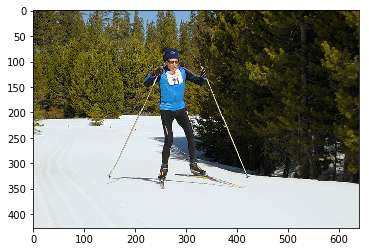

In [22]:
img = Image.open(fnames[70]).convert('RGB')
transform = transforms.Compose([transforms.ToTensor(),
                                tensor_normalizer()])
img_tensor = transform(img).unsqueeze(0)
if torch.cuda.is_available():
    img_tensor = img_tensor.cuda()
with torch.no_grad():
    img_output = transformer(Variable(img_tensor))
plt.imshow(recover_image(img_tensor.cpu().numpy())[0])

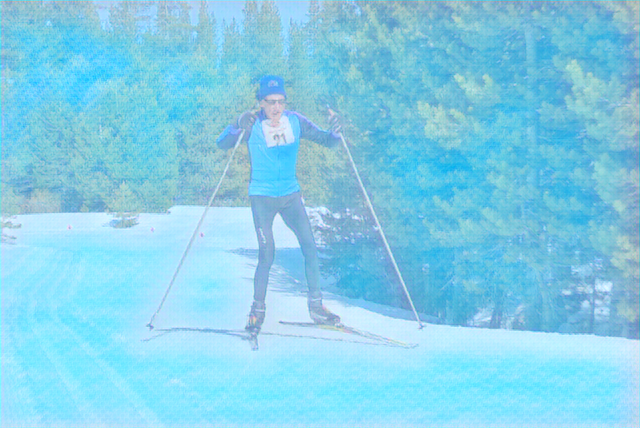

In [23]:
Image.fromarray(recover_image(img_output.data.cpu().numpy())[0])

/home/master/07/vincentwu929/anaconda3/envs/vincentenv/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:122: UserWarning: nn.Upsampling is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.Upsampling is deprecated. Use nn.functional.interpolate instead.")


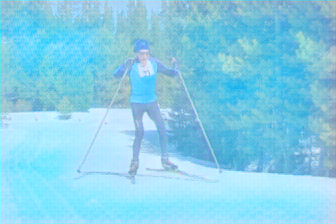

In [24]:
transform = transforms.Compose([transforms.Resize(IMAGE_SIZE),
                                transforms.ToTensor(),
                                tensor_normalizer()])
img_tensor = transform(img).unsqueeze(0)
if torch.cuda.is_available():
    img_tensor = img_tensor.cuda()
with torch.no_grad():
    img_output = transformer(Variable(img_tensor))
Image.fromarray(recover_image(img_output.data.cpu().numpy())[0])

# Stylize the content images

In [25]:
data_path = '/tmp2/vincentwu929/DIP_final/Sky/content/sky1/Video1_HR.avi'
mask_path = '/tmp2/vincentwu929/DIP_final/Sky/mask/mask_HR1.png'
video_name = 'Video1_HR'

In [26]:
video = cv2.VideoCapture(data_path)
mask = cv2.imread(mask_path).astype(np.bool)

In [27]:
frames=[]
i=0
while (video.isOpened()):
    ret, frame = video.read()
    if ret == True:
        rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(rgb_frame)
    else:
        break
video.release()

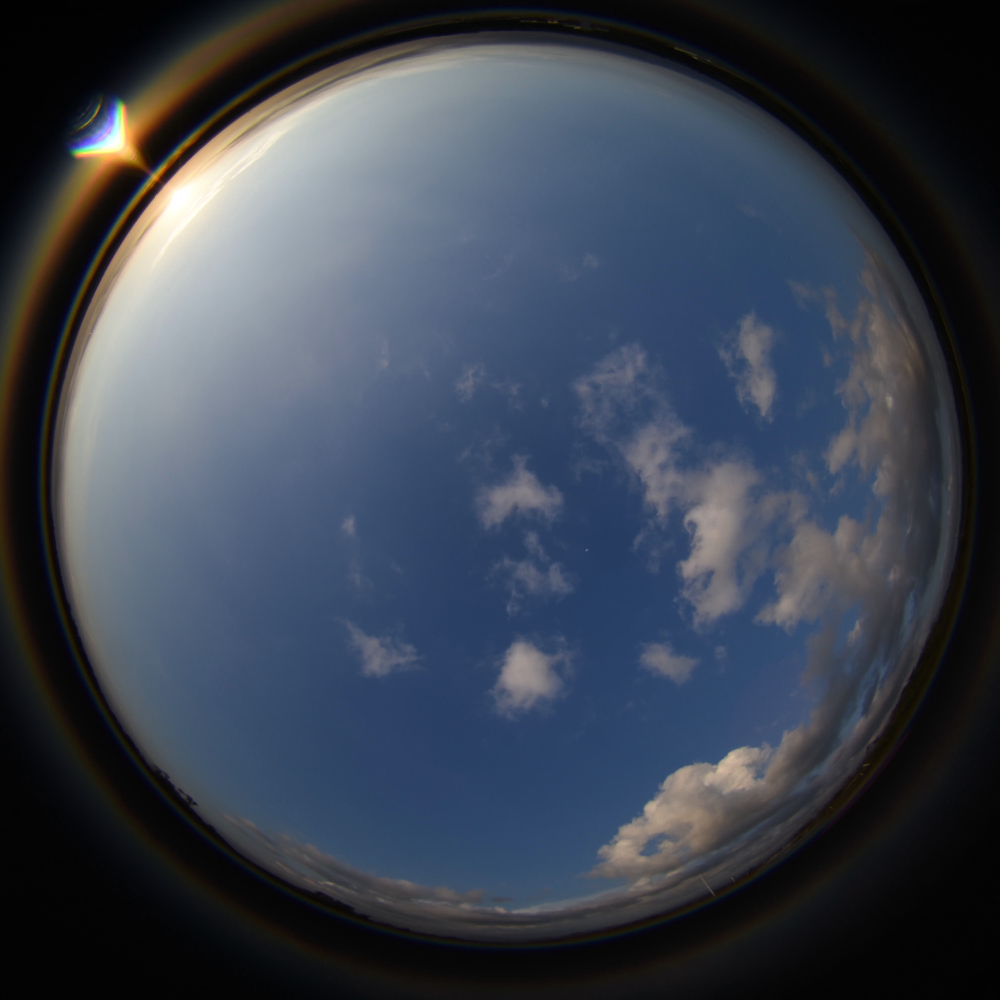

In [28]:
Image.fromarray(frames[0][0:4000,1000:5000])

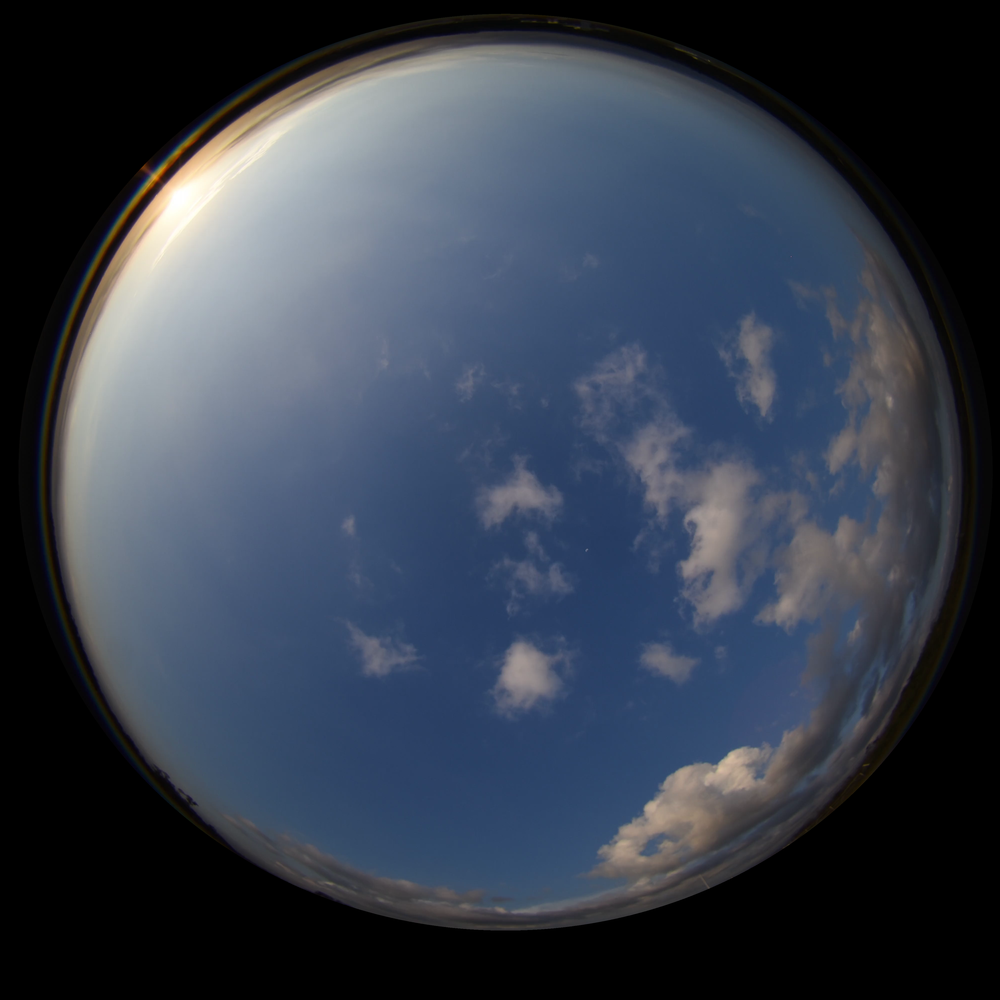

In [29]:
Image.fromarray(frames[0][0:4000,1000:5000]*mask)

In [30]:
transform = transforms.Compose([
    transforms.Resize(1024),
    transforms.ToTensor(),
    tensor_normalizer()])
frame = frames[0][0:4000,1000:5000]
img = Image.fromarray(frame)
img_tensor = transform(img).unsqueeze(0)
if torch.cuda.is_available():
    img_tensor = img_tensor.cuda()
with torch.no_grad():
    img_output = transformer(Variable(img_tensor))
profile_img = recover_image(img_output.data.cpu().numpy())[0]
profile_img = cv2.resize(profile_img, (4000, 4000), cv2.INTER_CUBIC)

/home/master/07/vincentwu929/anaconda3/envs/vincentenv/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:122: UserWarning: nn.Upsampling is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.Upsampling is deprecated. Use nn.functional.interpolate instead.")


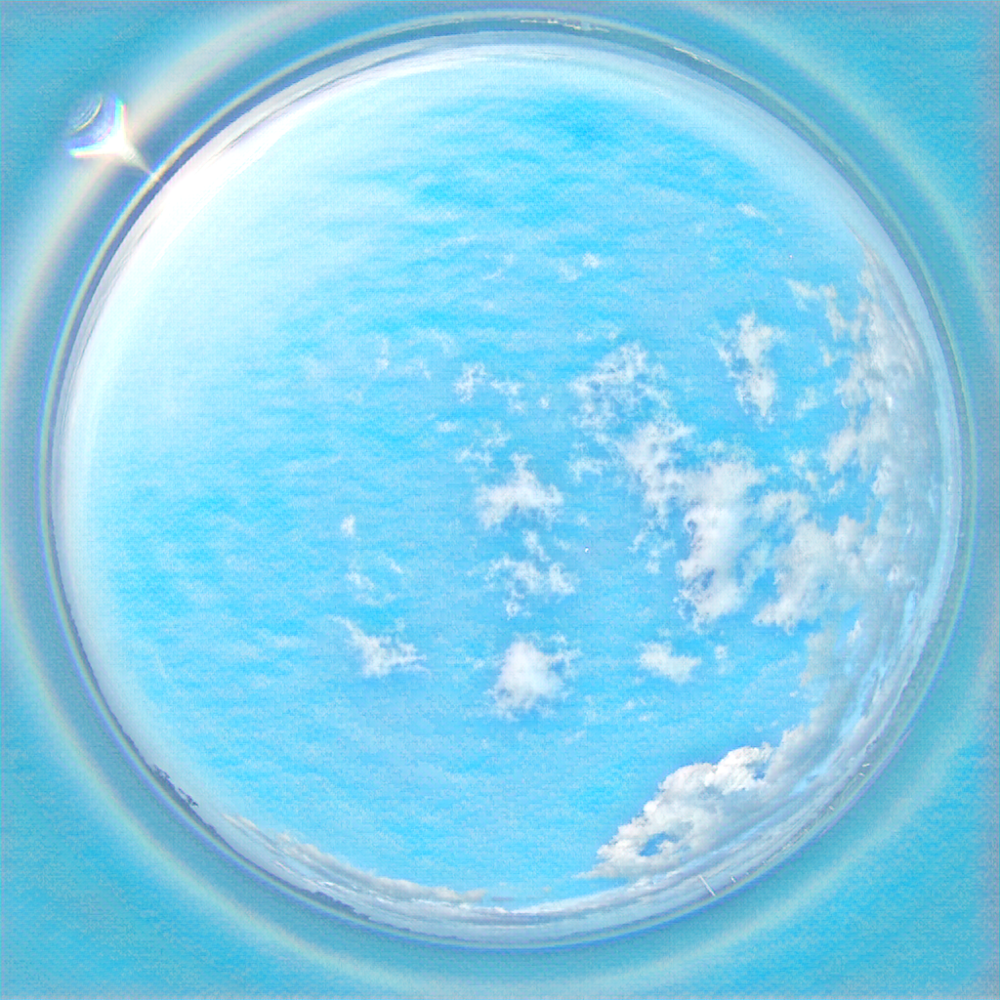

In [31]:
Image.fromarray(profile_img)

In [32]:
out_img = frames[0]
out_img[0:4000,1000:5000] = profile_img * mask + frames[0][0:4000,1000:5000] * (~mask)

In [34]:
output = Image.fromarray(out_img)

In [35]:
if not os.path.exists('./results'):
    os.makedirs('./results')
output.save('./results/frame_0000_{}_{}-stylized.jpg'.format(video_name, style_name))